In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 61.7 MB/s eta 0:00:00


In [2]:
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!mkdir -p "/content/data"

!cp "/content/drive/MyDrive/gender ditection/Gender Detection.v5i.yolov11.zip"  "/content/drive/MyDrive/gender ditection/Gender Detection.v5i.yolov11.zip"

!unzip -q "/content/drive/MyDrive/gender ditection/Gender Detection.v5i.yolov11.zip" -d "/content/data"

cp: '/content/drive/MyDrive/gender ditection/Gender Detection.v5i.yolov11.zip' and '/content/drive/MyDrive/gender ditection/Gender Detection.v5i.yolov11.zip' are the same file


In [5]:
model = YOLO("yolo11n.pt")

# Train the model
results = model.train(data="/content/data/data.yaml",
                      epochs=30,
                      imgsz=640,
                       save_dir="/content/drive/MyDrive/gender ditection/results/exp1"
                      )

Ultralytics 8.3.241 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, 


0: 640x640 1 female, 6.8ms
1: 640x640 1 female, 6.8ms
2: 640x640 4 females, 4 males, 6.8ms
Speed: 3.6ms preprocess, 6.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


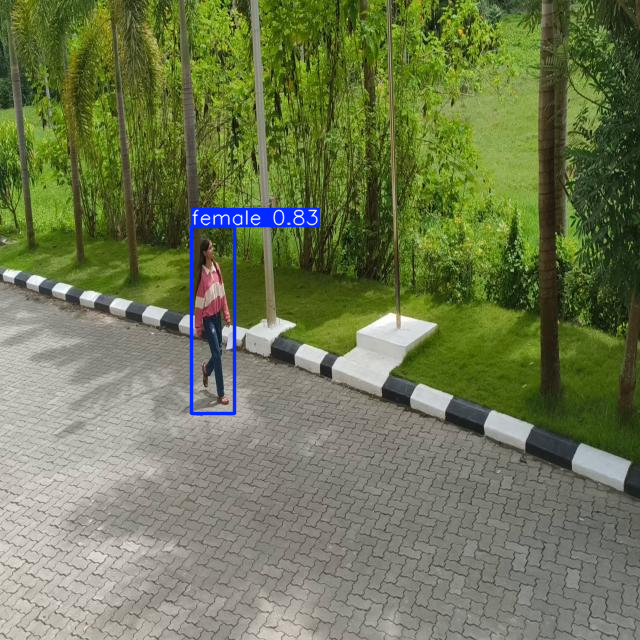

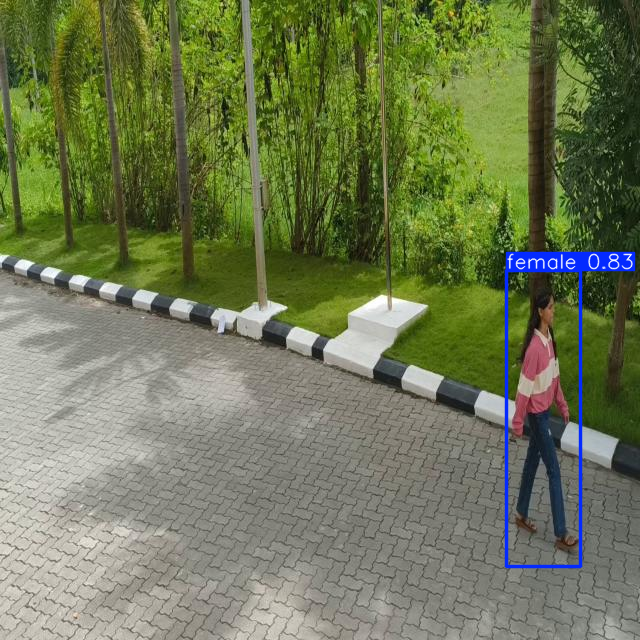

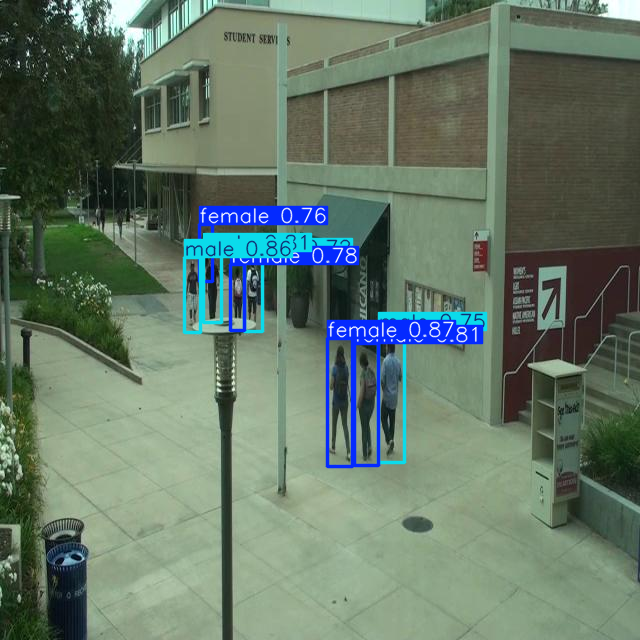

In [18]:
img1 = "/content/drive/MyDrive/Roboflow data set/Gender Detection.v5i.yolov11/test/images/1F_frame_00035_jpg.rf.fc49765c000ef47e0f1008379b6741de.jpg"
img2 = "/content/drive/MyDrive/Roboflow data set/Gender Detection.v5i.yolov11/test/images/1F_frame_00059_jpg.rf.ac14874cef5293782fe93b0ebe17d8f3.jpg"
img3 = "/content/drive/MyDrive/Roboflow data set/Gender Detection.v5i.yolov11/test/images/pedestrian2_frame_00026_jpg.rf.b941ff678c1b6e168af735ed9e340637.jpg"
results = model([img1, img2, img3])  # return a list of Results objects

# Process results list
for result in results:
    boxes = result.boxes  # Boxes object for bounding box outputs
    masks = result.masks  # Masks object for segmentation masks outputs
    keypoints = result.keypoints  # Keypoints object for pose outputs
    probs = result.probs  # Probs object for classification outputs
    obb = result.obb  # Oriented boxes object for OBB outputs
    result.show()  # display to screen
    result.save(filename="result.jpg")  # save to disk


0: 448x640 2 males, 12.0ms
Speed: 3.8ms preprocess, 12.0ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


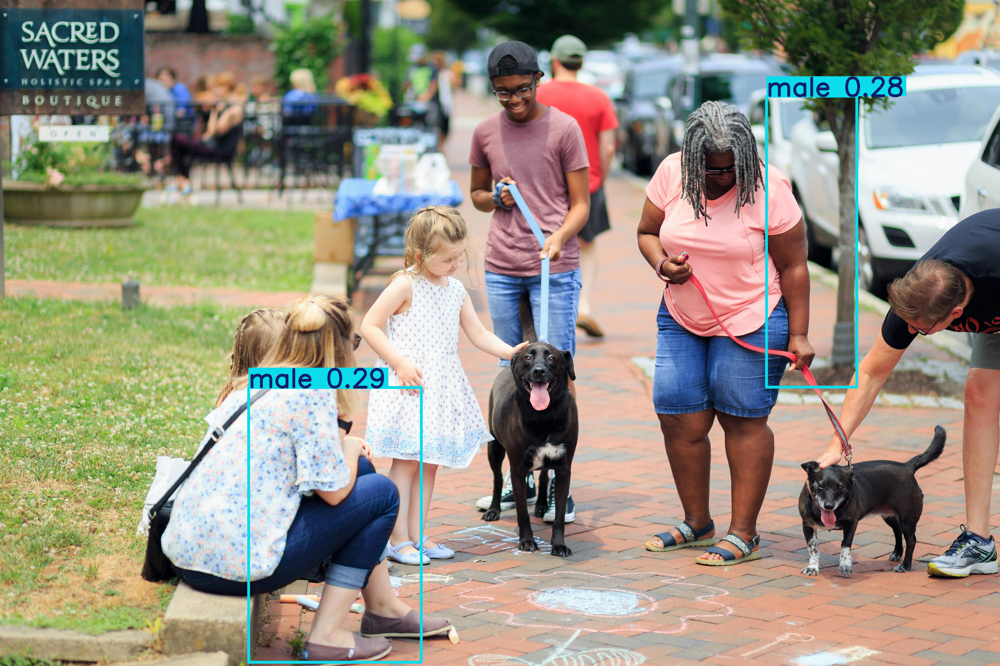

In [20]:
img4 = "/content/drive/MyDrive/image dataset/pexels-michael-morse-2414845.jpg"

results = model([img4])  # return a list of Results objects

# Process results list
for result in results:
    boxes = result.boxes  # Boxes object for bounding box outputs
    masks = result.masks  # Masks object for segmentation masks outputs
    keypoints = result.keypoints  # Keypoints object for pose outputs
    probs = result.probs  # Probs object for classification outputs
    obb = result.obb  # Oriented boxes object for OBB outputs
    result.show()  # display to screen
    result.save(filename="result.jpg")  # save to disk